📂 데이터 로드 중...
✅ 총 2687장 로드
✅ 클러스터 수: 10개

📊 검증 1: t-SNE 2D 시각화
⏳ t-SNE 계산 중 (약 2~3분)...


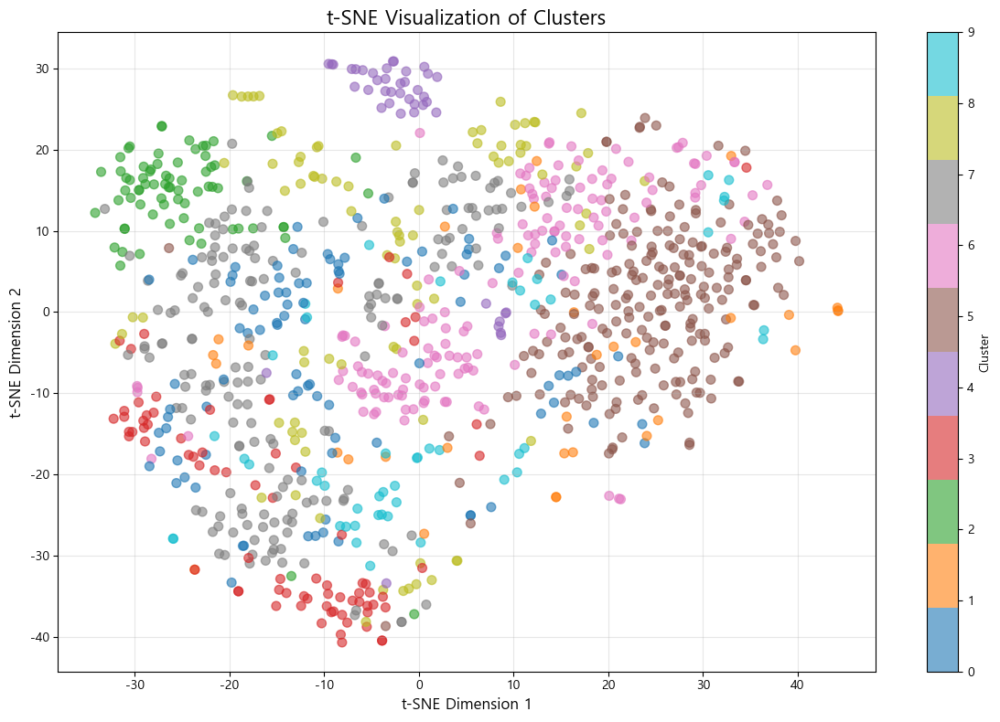

✅ t-SNE 플롯 저장: cluster_tsne.png

📊 검증 2: Silhouette 분석
전체 Silhouette Score: 0.0137


ValueError: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)

In [6]:
# ======================================================
# 📊 TryAngle Cluster Validation Notebook
# 클러스터링 품질 검증 (현업 스타일)
# ======================================================

import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import confusion_matrix, adjusted_rand_score
import cv2
from PIL import Image
import os
from IPython.display import display, HTML
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# ======================================================
# [1] 데이터 로드
# ======================================================

PARQUET_PATH = r"C:\try_angle\features\clustered_umap_v2_result.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"
CLUSTER_DIR = r"C:\try_angle\data\clustered_images"

print("📂 데이터 로드 중...")
df = pl.read_parquet(PARQUET_PATH)

# 특징 추출
clip_feats = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
dino_feats = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
labels = df.select("cluster").to_numpy().flatten()
filenames = df.select("filename").to_series().to_list()

print(f"✅ 총 {len(df)}장 로드")
print(f"✅ 클러스터 수: {len(np.unique(labels))}개")

# ======================================================
# [검증 1] 시각화 - t-SNE 2D 플롯
# ======================================================

print("\n" + "="*70)
print("📊 검증 1: t-SNE 2D 시각화")
print("="*70)

# t-SNE 차원 축소 (시각화용)
print("⏳ t-SNE 계산 중 (약 2~3분)...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
features_2d = tsne.fit_transform(clip_feats[:1000])  # 샘플 1000개만 (속도)

# 플롯
plt.figure(figsize=(12, 8))
scatter = plt.scatter(features_2d[:, 0], features_2d[:, 1], 
                     c=labels[:1000], cmap='tab10', 
                     alpha=0.6, s=50)
plt.colorbar(scatter, label='Cluster')
plt.title('t-SNE Visualization of Clusters', fontsize=16)
plt.xlabel('t-SNE Dimension 1', fontsize=12)
plt.ylabel('t-SNE Dimension 2', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_tsne.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ t-SNE 플롯 저장: cluster_tsne.png")

# ======================================================
# [검증 2] Silhouette 분석 (클러스터별)
# ======================================================

print("\n" + "="*70)
print("📊 검증 2: Silhouette 분석")
print("="*70)

# 전체 Silhouette
overall_sil = silhouette_score(clip_feats, labels, sample_size=5000)
print(f"전체 Silhouette Score: {overall_sil:.4f}")

# 클러스터별 Silhouette
cluster_sil = []
for c in range(len(np.unique(labels))):
    mask = labels == c
    if mask.sum() < 2:
        cluster_sil.append(0)
        continue
    
    # 클러스터 내 샘플들의 Silhouette
    sample_sil = silhouette_samples(clip_feats[mask], labels[mask])
    cluster_sil.append(sample_sil.mean())

# 막대 그래프
plt.figure(figsize=(12, 6))
colors = plt.cm.tab10(np.arange(len(cluster_sil)))
bars = plt.bar(range(len(cluster_sil)), cluster_sil, color=colors, alpha=0.7)
plt.axhline(y=overall_sil, color='r', linestyle='--', label=f'Overall ({overall_sil:.3f})')
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Silhouette Score', fontsize=12)
plt.title('클러스터별 Silhouette Score', fontsize=16)
plt.legend()
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_silhouette.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n📊 클러스터별 Silhouette:")
for i, score in enumerate(cluster_sil):
    size = (labels == i).sum()
    grade = "좋음" if score > 0.4 else ("보통" if score > 0.2 else "낮음")
    print(f"  Cluster {i}: {score:.3f} ({size}장) - {grade}")

print("\n✅ Silhouette 플롯 저장: cluster_silhouette.png")

# ======================================================
# [검증 3] 클러스터 크기 분포
# ======================================================

print("\n" + "="*70)
print("📊 검증 3: 클러스터 크기 분포")
print("="*70)

cluster_sizes = [((labels == c).sum()) for c in range(len(np.unique(labels)))]

plt.figure(figsize=(12, 6))
bars = plt.bar(range(len(cluster_sizes)), cluster_sizes, 
               color=plt.cm.tab10(np.arange(len(cluster_sizes))), alpha=0.7)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Image Count', fontsize=12)
plt.title('클러스터별 이미지 개수', fontsize=16)

# 막대 위에 숫자 표시
for i, (bar, size) in enumerate(zip(bars, cluster_sizes)):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{size}',
             ha='center', va='bottom', fontsize=10)

plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_sizes.png', dpi=150, bbox_inches='tight')
plt.show()

# 불균형 체크
max_size = max(cluster_sizes)
min_size = min(cluster_sizes)
imbalance_ratio = max_size / min_size

print(f"\n📊 크기 분포:")
print(f"  최대: {max_size}장 (Cluster {cluster_sizes.index(max_size)})")
print(f"  최소: {min_size}장 (Cluster {cluster_sizes.index(min_size)})")
print(f"  불균형 비율: {imbalance_ratio:.1f}배")

if imbalance_ratio > 10:
    print("  ⚠️ 경고: 클러스터 크기 불균형이 큽니다 (10배 이상)")
elif imbalance_ratio > 5:
    print("  ⚠️ 주의: 클러스터 크기 차이가 있습니다 (5배 이상)")
else:
    print("  ✅ 양호: 클러스터 크기가 비교적 균형적입니다")

print("\n✅ 크기 분포 플롯 저장: cluster_sizes.png")

# ======================================================
# [검증 4] 대표 이미지 그리드 (시각적 검증)
# ======================================================

print("\n" + "="*70)
print("📊 검증 4: 대표 이미지 그리드")
print("="*70)

def create_cluster_grid(cluster_id, n_samples=9):
    """클러스터 대표 이미지 그리드 생성"""
    cluster_files = [f for i, f in enumerate(filenames) if labels[i] == cluster_id]
    
    # 랜덤 샘플링
    if len(cluster_files) > n_samples:
        import random
        cluster_files = random.sample(cluster_files, n_samples)
    
    n_samples = len(cluster_files)
    n_cols = 3
    n_rows = (n_samples + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4*n_rows))
    axes = axes.flatten() if n_samples > 1 else [axes]
    
    for idx, fname in enumerate(cluster_files):
        img_path = os.path.join(IMG_DIR, os.path.basename(fname))
        
        try:
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (300, 400))
                axes[idx].imshow(img)
                axes[idx].set_title(os.path.basename(fname)[:20], fontsize=8)
                axes[idx].axis('off')
        except Exception as e:
            axes[idx].text(0.5, 0.5, 'Load Error', 
                          ha='center', va='center')
            axes[idx].axis('off')
    
    # 빈 subplot 제거
    for idx in range(n_samples, len(axes)):
        axes[idx].axis('off')
    
    plt.suptitle(f'Cluster {cluster_id} 대표 이미지 ({len(cluster_files)}장 샘플)', 
                 fontsize=16, y=1.00)
    plt.tight_layout()
    plt.savefig(f'cluster_{cluster_id}_samples.png', dpi=100, bbox_inches='tight')
    plt.show()

# 각 클러스터 시각화 (0, 5, 8번만 예시)
for c in [0, 5, 8]:
    print(f"\n클러스터 {c} 시각화 중...")
    create_cluster_grid(c, n_samples=9)

print("\n✅ 대표 이미지 저장 완료")

# ======================================================
# [검증 5] 클러스터 간 거리 행렬
# ======================================================

print("\n" + "="*70)
print("📊 검증 5: 클러스터 간 거리 분석")
print("="*70)

# 클러스터 중심 계산
cluster_centers = []
for c in range(len(np.unique(labels))):
    mask = labels == c
    center = clip_feats[mask].mean(axis=0)
    cluster_centers.append(center)

cluster_centers = np.array(cluster_centers)

# 거리 행렬 계산 (코사인 거리)
from scipy.spatial.distance import cdist
distance_matrix = cdist(cluster_centers, cluster_centers, metric='cosine')

# 히트맵
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True, fmt='.2f', cmap='RdYlGn_r',
            xticklabels=range(len(cluster_centers)),
            yticklabels=range(len(cluster_centers)),
            cbar_kws={'label': 'Cosine Distance'})
plt.title('클러스터 간 거리 행렬 (낮을수록 유사)', fontsize=16)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Cluster ID', fontsize=12)
plt.tight_layout()
plt.savefig('cluster_distance_matrix.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ 거리 행렬 저장: cluster_distance_matrix.png")

# 가장 가까운 클러스터 쌍
min_dist = np.inf
closest_pair = None
for i in range(len(cluster_centers)):
    for j in range(i+1, len(cluster_centers)):
        if distance_matrix[i, j] < min_dist:
            min_dist = distance_matrix[i, j]
            closest_pair = (i, j)

print(f"\n가장 유사한 클러스터: {closest_pair[0]} ↔ {closest_pair[1]} (거리: {min_dist:.3f})")
print("  → 이 두 클러스터를 합칠지 고려해볼 수 있습니다")

# ======================================================
# [검증 6] 안정성 테스트 (Stability Test)
# ======================================================

print("\n" + "="*70)
print("📊 검증 6: 클러스터링 안정성 테스트")
print("="*70)

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

print("⏳ 안정성 테스트 중 (약 1분)...")

stability_scores = []
n_trials = 5

for trial in range(n_trials):
    # 데이터 80% 샘플링
    sample_idx = np.random.choice(len(clip_feats), size=int(len(clip_feats)*0.8), replace=False)
    sample_feats = clip_feats[sample_idx]
    sample_labels = labels[sample_idx]
    
    # 재클러스터링
    km = KMeans(n_clusters=10, random_state=trial, n_init=10)
    new_labels = km.fit_predict(sample_feats)
    
    # ARI (Adjusted Rand Index) 계산
    ari = adjusted_rand_score(sample_labels, new_labels)
    stability_scores.append(ari)

avg_stability = np.mean(stability_scores)
std_stability = np.std(stability_scores)

print(f"\n안정성 점수 (ARI): {avg_stability:.3f} ± {std_stability:.3f}")

if avg_stability > 0.8:
    print("  ✅ 우수: 클러스터링이 매우 안정적입니다")
elif avg_stability > 0.6:
    print("  ✅ 양호: 클러스터링이 비교적 안정적입니다")
elif avg_stability > 0.4:
    print("  ⚠️ 보통: 약간의 변동성이 있습니다")
else:
    print("  ⚠️ 주의: 클러스터링이 불안정합니다 (파라미터 조정 필요)")

# ======================================================
# [종합 리포트]
# ======================================================

print("\n" + "="*70)
print("📋 종합 검증 리포트")
print("="*70)

report = f"""
✅ 데이터 품질
  - 총 샘플 수: {len(df)}장
  - 클러스터 수: {len(np.unique(labels))}개
  
✅ 정량 지표
  - Silhouette Score: {overall_sil:.4f} ({'우수' if overall_sil > 0.4 else '양호' if overall_sil > 0.2 else '낮음'})
  - 안정성 (ARI): {avg_stability:.3f} ({'안정' if avg_stability > 0.6 else '보통' if avg_stability > 0.4 else '불안정'})
  
✅ 균형성
  - 최대/최소 비율: {imbalance_ratio:.1f}배 ({'양호' if imbalance_ratio < 5 else '주의' if imbalance_ratio < 10 else '불균형'})
  
✅ 분리도
  - 가장 가까운 클러스터: {closest_pair[0]} ↔ {closest_pair[1]} (거리: {min_dist:.3f})
  - {'분리 양호' if min_dist > 0.3 else '일부 중첩'}
  
💡 권장 사항:
"""

if overall_sil < 0.3:
    report += "  - Silhouette가 낮음 → 클러스터 수 조정 권장 (5~15개 테스트)\n"
if imbalance_ratio > 10:
    report += "  - 크기 불균형 → 큰 클러스터 세분화 고려\n"
if min_dist < 0.2:
    report += f"  - Cluster {closest_pair[0]}와 {closest_pair[1]} 병합 고려\n"
if avg_stability < 0.5:
    report += "  - 안정성 낮음 → 샘플 수 늘리거나 특징 재선택\n"

if overall_sil > 0.4 and avg_stability > 0.6 and imbalance_ratio < 5:
    report += "  ✅ 현재 클러스터링이 우수합니다! 그대로 사용 가능합니다.\n"

print(report)

# 리포트 저장
with open('clustering_validation_report.txt', 'w', encoding='utf-8') as f:
    f.write(report)

print("\n✅ 리포트 저장: clustering_validation_report.txt")
print("="*70)


📂 데이터 로드 중...
✅ 총 2687장 로드
✅ 클러스터 수: 10개

📊 검증 1: t-SNE 2D 시각화
⏳ t-SNE 계산 중 (약 2~3분)...


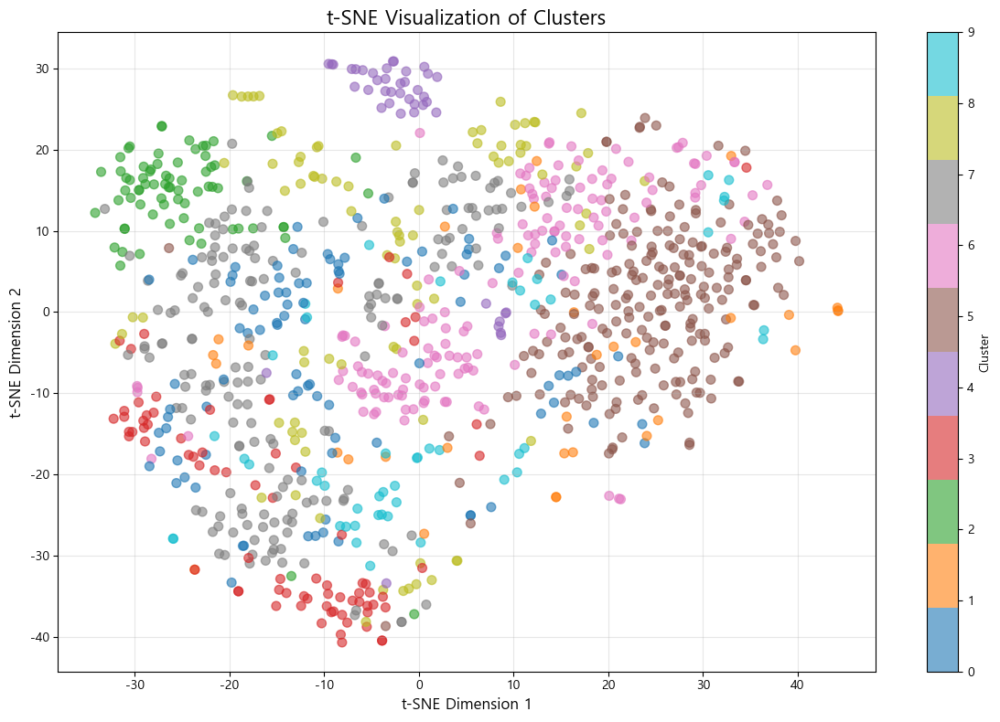

✅ t-SNE 플롯 저장: cluster_tsne.png

📊 검증 2: Silhouette 분석
전체 Silhouette Score: 0.0137
⏳ 클러스터별 silhouette 계산 중...


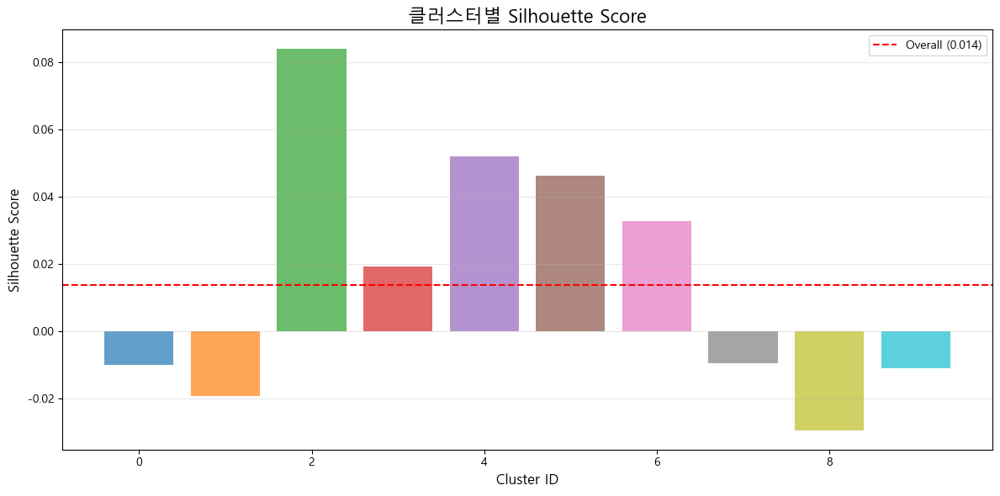


📊 클러스터별 Silhouette:
  Cluster 0: -0.010 (288장) - 낮음
  Cluster 1: -0.019 (242장) - 낮음
  Cluster 2: 0.084 (134장) - 낮음
  Cluster 3: 0.019 (202장) - 낮음
  Cluster 4: 0.052 (122장) - 낮음
  Cluster 5: 0.046 (597장) - 낮음
  Cluster 6: 0.033 (268장) - 낮음
  Cluster 7: -0.010 (413장) - 낮음
  Cluster 8: -0.030 (266장) - 낮음
  Cluster 9: -0.011 (155장) - 낮음

✅ Silhouette 플롯 저장: cluster_silhouette.png

📊 검증 3: 클러스터 크기 분포


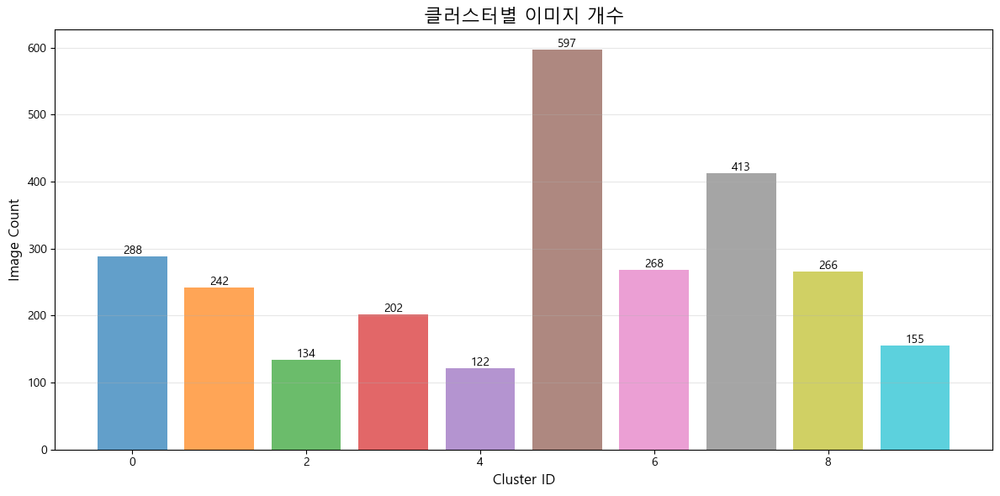


📊 크기 분포:
  최대: 597장
  최소: 122장
  불균형 비율: 4.9배

✅ 크기 분포 플롯 저장: cluster_sizes.png

📊 검증 4: 대표 이미지 그리드

클러스터 0 시각화 중...


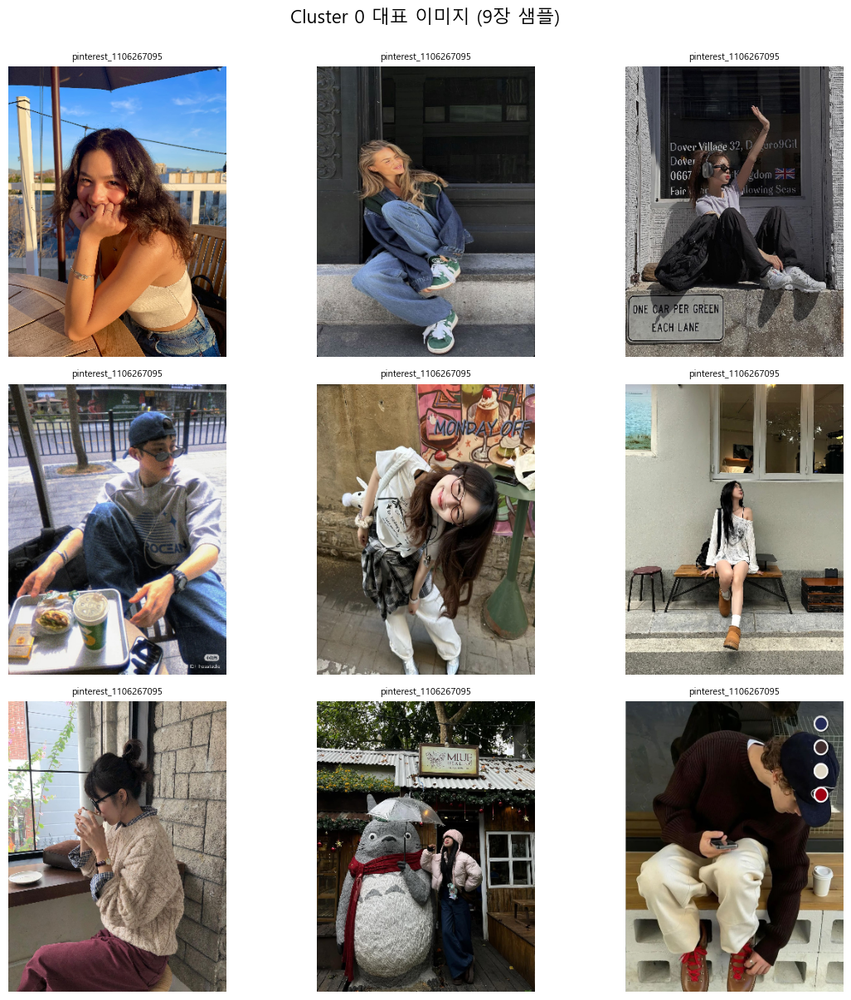


클러스터 5 시각화 중...


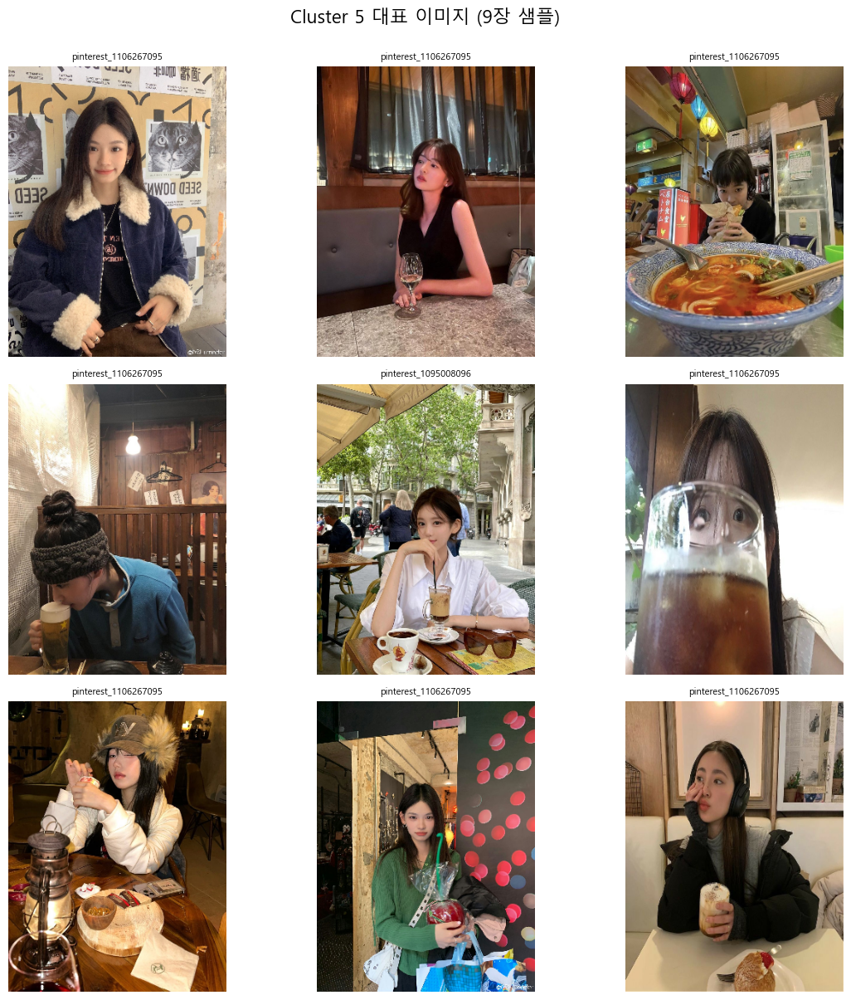


클러스터 8 시각화 중...


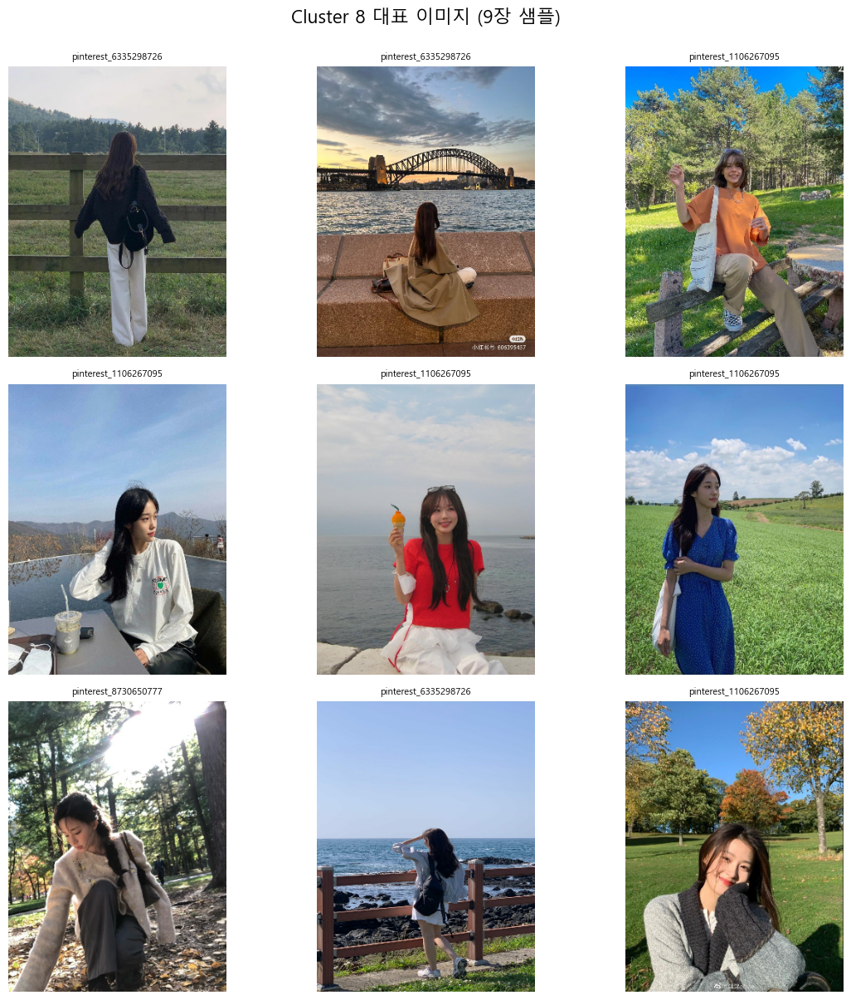


✅ 대표 이미지 저장 완료

📊 검증 5: 클러스터 간 거리 분석


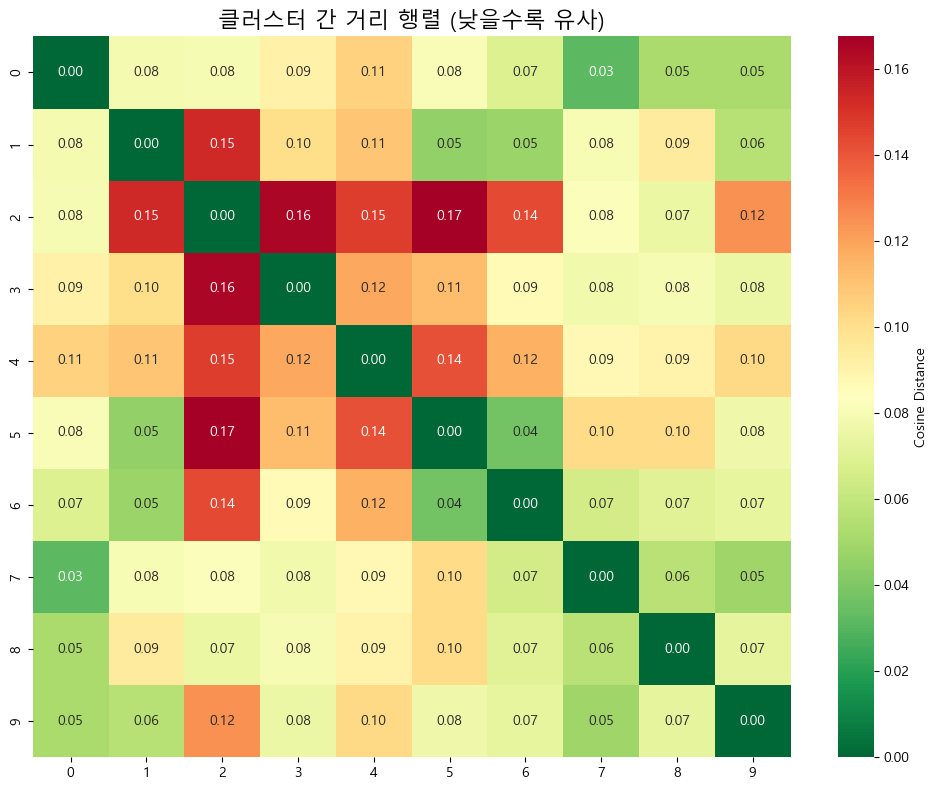

✅ 거리 행렬 저장: cluster_distance_matrix.png

가장 유사한 클러스터: 0 ↔ 7 (거리: 0.032)

📊 검증 6: 클러스터링 안정성 테스트
⏳ 안정성 테스트 중 (약 1분)...

안정성 점수 (ARI): 0.220 ± 0.022

📋 종합 검증 리포트

✅ 리포트 저장: clustering_validation_report.txt


In [7]:
# ======================================================
# 📊 TryAngle Cluster Validation Notebook (Fixed Version)
# 클러스터링 품질 검증 (전체 코드 + Silhouette 완전 수정)
# ======================================================

import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import confusion_matrix, adjusted_rand_score
import cv2
from PIL import Image
import os
from IPython.display import display, HTML
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# ======================================================
# [1] 데이터 로드
# ======================================================

PARQUET_PATH = r"C:\try_angle\features\clustered_umap_v2_result.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"
CLUSTER_DIR = r"C:\try_angle\data\clustered_images"

print("📂 데이터 로드 중...")
df = pl.read_parquet(PARQUET_PATH)

# 특징 추출
clip_feats = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
dino_feats = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
labels = df.select("cluster").to_numpy().flatten()
filenames = df.select("filename").to_series().to_list()

print(f"✅ 총 {len(df)}장 로드")
print(f"✅ 클러스터 수: {len(np.unique(labels))}개")

# ======================================================
# [검증 1] t-SNE 시각화
# ======================================================

print("\n" + "="*70)
print("📊 검증 1: t-SNE 2D 시각화")
print("="*70)

print("⏳ t-SNE 계산 중 (약 2~3분)...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
features_2d = tsne.fit_transform(clip_feats[:1000])  # 샘플 1000개만 (속도)

plt.figure(figsize=(12, 8))
scatter = plt.scatter(features_2d[:, 0], features_2d[:, 1],
                     c=labels[:1000], cmap='tab10',
                     alpha=0.6, s=50)
plt.colorbar(scatter, label='Cluster')
plt.title('t-SNE Visualization of Clusters', fontsize=16)
plt.xlabel('t-SNE Dimension 1', fontsize=12)
plt.ylabel('t-SNE Dimension 2', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_tsne.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ t-SNE 플롯 저장: cluster_tsne.png")

# ======================================================
# [검증 2] Silhouette 분석 (완전 수정)
# ======================================================

print("\n" + "="*70)
print("📊 검증 2: Silhouette 분석")
print("="*70)

# 전체 Silhouette Score
overall_sil = silhouette_score(clip_feats, labels, sample_size=min(len(clip_feats), 5000))
print(f"전체 Silhouette Score: {overall_sil:.4f}")

# 전체 데이터에 대해 silhouette_samples 계산
print("⏳ 클러스터별 silhouette 계산 중...")
sil_all = silhouette_samples(clip_feats, labels)

cluster_sil = []
unique_clusters = np.unique(labels)

for c in unique_clusters:
    mask = labels == c
    if mask.sum() < 2:
        cluster_sil.append(0)
    else:
        cluster_sil.append(sil_all[mask].mean())

# 그래프
plt.figure(figsize=(12, 6))
colors = plt.cm.tab10(np.arange(len(cluster_sil)))
plt.bar(range(len(cluster_sil)), cluster_sil, color=colors, alpha=0.7)
plt.axhline(y=overall_sil, color='r', linestyle='--',
            label=f'Overall ({overall_sil:.3f})')
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Silhouette Score', fontsize=12)
plt.title('클러스터별 Silhouette Score', fontsize=16)
plt.legend()
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_silhouette.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n📊 클러스터별 Silhouette:")
for i, score in enumerate(cluster_sil):
    size = (labels == unique_clusters[i]).sum()
    grade = "좋음" if score > 0.4 else ("보통" if score > 0.2 else "낮음")
    print(f"  Cluster {unique_clusters[i]}: {score:.3f} ({size}장) - {grade}")

print("\n✅ Silhouette 플롯 저장: cluster_silhouette.png")

# ======================================================
# [검증 3] 클러스터 크기 분포
# ======================================================

print("\n" + "="*70)
print("📊 검증 3: 클러스터 크기 분포")
print("="*70)

cluster_sizes = [((labels == c).sum()) for c in unique_clusters]

plt.figure(figsize=(12, 6))
bars = plt.bar(unique_clusters, cluster_sizes,
               color=plt.cm.tab10(np.arange(len(cluster_sizes))), alpha=0.7)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Image Count', fontsize=12)
plt.title('클러스터별 이미지 개수', fontsize=16)

# 막대 값 표기
for bar, size in zip(bars, cluster_sizes):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{size}', ha='center', va='bottom', fontsize=10)

plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_sizes.png', dpi=150, bbox_inches='tight')
plt.show()

max_size = max(cluster_sizes)
min_size = min(cluster_sizes)
imbalance_ratio = max_size / min_size

print(f"\n📊 크기 분포:")
print(f"  최대: {max_size}장")
print(f"  최소: {min_size}장")
print(f"  불균형 비율: {imbalance_ratio:.1f}배")

print("\n✅ 크기 분포 플롯 저장: cluster_sizes.png")

# ======================================================
# [검증 4] 대표 이미지 그리드
# ======================================================

print("\n" + "="*70)
print("📊 검증 4: 대표 이미지 그리드")
print("="*70)

def create_cluster_grid(cluster_id, n_samples=9):
    """클러스터 대표 이미지 그리드 생성"""
    cluster_files = [f for i, f in enumerate(filenames) if labels[i] == cluster_id]
    
    # 랜덤 샘플링
    if len(cluster_files) > n_samples:
        import random
        cluster_files = random.sample(cluster_files, n_samples)
    
    n_samples = len(cluster_files)
    n_cols = 3
    n_rows = (n_samples + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4*n_rows))
    axes = axes.flatten() if n_samples > 1 else [axes]
    
    for idx, fname in enumerate(cluster_files):
        img_path = os.path.join(IMG_DIR, os.path.basename(fname))
        try:
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (300, 400))
                axes[idx].imshow(img)
                axes[idx].set_title(os.path.basename(fname)[:20], fontsize=8)
                axes[idx].axis('off')
        except:
            axes[idx].text(0.5, 0.5, 'Load Error', ha='center', va='center')
            axes[idx].axis('off')
    
    for idx in range(n_samples, len(axes)):
        axes[idx].axis('off')
    
    plt.suptitle(f'Cluster {cluster_id} 대표 이미지 ({len(cluster_files)}장 샘플)',
                 fontsize=16, y=1.00)
    plt.tight_layout()
    plt.savefig(f'cluster_{cluster_id}_samples.png', dpi=100, bbox_inches='tight')
    plt.show()

for c in [0, 5, 8]:
    print(f"\n클러스터 {c} 시각화 중...")
    create_cluster_grid(c, n_samples=9)

print("\n✅ 대표 이미지 저장 완료")

# ======================================================
# [검증 5] 클러스터 간 거리 분석
# ======================================================

print("\n" + "="*70)
print("📊 검증 5: 클러스터 간 거리 분석")
print("="*70)

cluster_centers = []
for c in unique_clusters:
    mask = labels == c
    center = clip_feats[mask].mean(axis=0)
    cluster_centers.append(center)

cluster_centers = np.array(cluster_centers)

from scipy.spatial.distance import cdist
distance_matrix = cdist(cluster_centers, cluster_centers, metric='cosine')

plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True, fmt='.2f', cmap='RdYlGn_r',
            xticklabels=unique_clusters, yticklabels=unique_clusters,
            cbar_kws={'label': 'Cosine Distance'})
plt.title('클러스터 간 거리 행렬 (낮을수록 유사)', fontsize=16)
plt.tight_layout()
plt.savefig('cluster_distance_matrix.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ 거리 행렬 저장: cluster_distance_matrix.png")

min_dist = np.inf
closest_pair = None
for i in range(len(cluster_centers)):
    for j in range(i+1, len(cluster_centers)):
        if distance_matrix[i, j] < min_dist:
            min_dist = distance_matrix[i, j]
            closest_pair = (unique_clusters[i], unique_clusters[j])

print(f"\n가장 유사한 클러스터: {closest_pair[0]} ↔ {closest_pair[1]} (거리: {min_dist:.3f})")

# ======================================================
# [검증 6] 안정성 테스트
# ======================================================

print("\n" + "="*70)
print("📊 검증 6: 클러스터링 안정성 테스트")
print("="*70)

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

print("⏳ 안정성 테스트 중 (약 1분)...")

stability_scores = []
n_trials = 5

for trial in range(n_trials):
    sample_idx = np.random.choice(len(clip_feats), size=int(len(clip_feats)*0.8), replace=False)
    sample_feats = clip_feats[sample_idx]
    sample_labels = labels[sample_idx]
    
    km = KMeans(n_clusters=len(unique_clusters), random_state=trial, n_init=10)
    new_labels = km.fit_predict(sample_feats)
    
    ari = adjusted_rand_score(sample_labels, new_labels)
    stability_scores.append(ari)

avg_stability = np.mean(stability_scores)
std_stability = np.std(stability_scores)

print(f"\n안정성 점수 (ARI): {avg_stability:.3f} ± {std_stability:.3f}")

# ======================================================
# [종합 리포트]
# ======================================================

print("\n" + "="*70)
print("📋 종합 검증 리포트")
print("="*70)

report = f"""
✅ 데이터 품질
  - 총 샘플 수: {len(df)}장
  - 클러스터 수: {len(unique_clusters)}개
  
✅ 정량 지표
  - Silhouette Score: {overall_sil:.4f}
  - 안정성 (ARI): {avg_stability:.3f}
  
"""

with open('clustering_validation_report.txt', 'w', encoding='utf-8') as f:
    f.write(report)

print("\n✅ 리포트 저장: clustering_validation_report.txt")
print("="*70)


📂 데이터 로드 중...
⚠️ UMAP 특징 없음! 융합 특징 생성 중...
✅ 융합 특징 생성: 898차원
✅ 총 2687장
✅ 클러스터 수: 10개

📊 검증 1: t-SNE 2D 시각화
⏳ t-SNE 계산 중 (약 2분)...


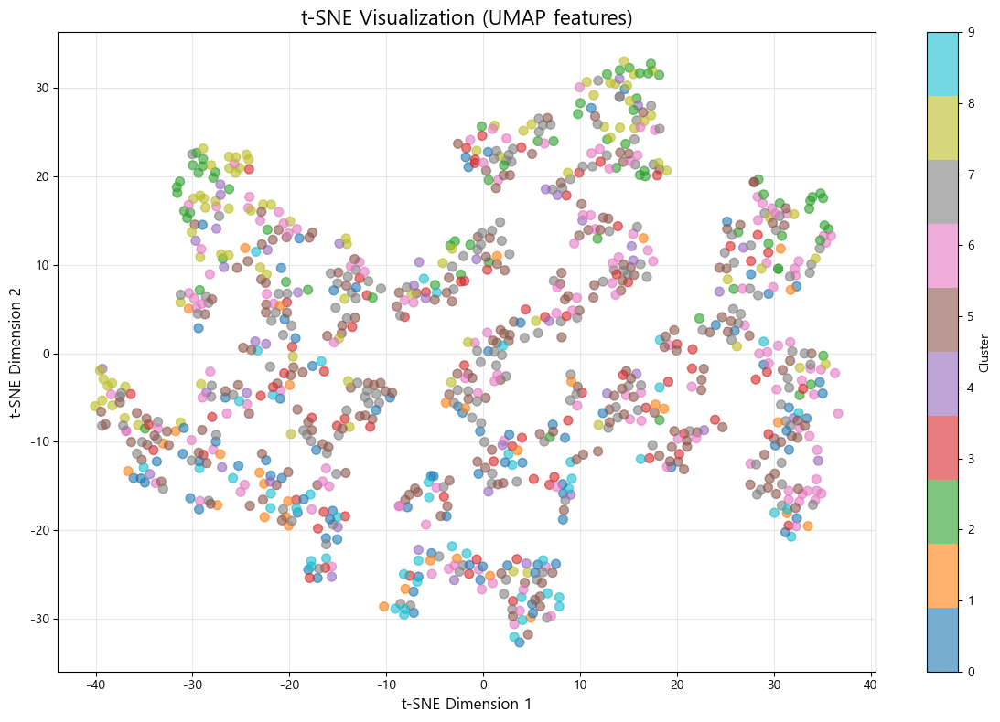

✅ t-SNE 플롯 저장: cluster_tsne_fixed.png

📊 검증 2: Silhouette 분석
전체 Silhouette Score: -0.1014


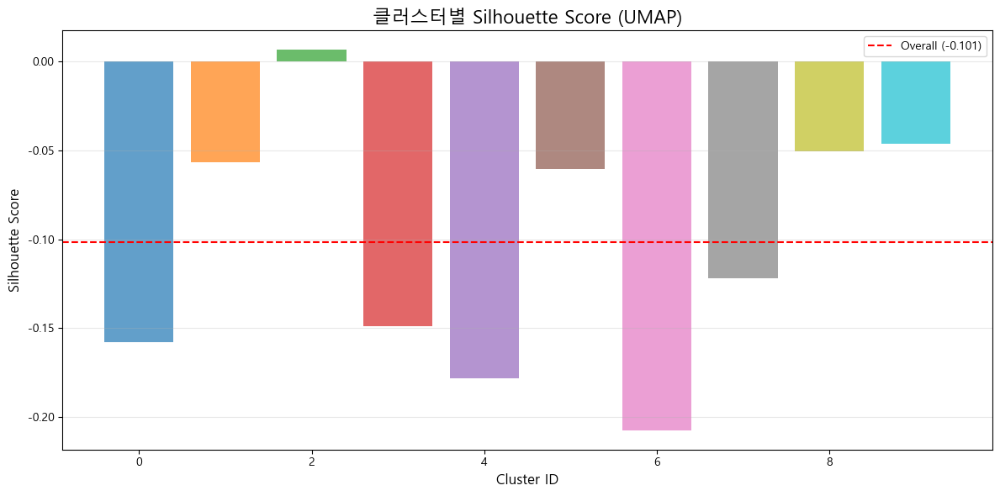


📊 클러스터별 Silhouette:
  Cluster 0: -0.158 (288장) - 낮음
  Cluster 1: -0.057 (242장) - 낮음
  Cluster 2: 0.007 (134장) - 낮음
  Cluster 3: -0.149 (202장) - 낮음
  Cluster 4: -0.178 (122장) - 낮음
  Cluster 5: -0.060 (597장) - 낮음
  Cluster 6: -0.208 (268장) - 낮음
  Cluster 7: -0.122 (413장) - 낮음
  Cluster 8: -0.050 (266장) - 낮음
  Cluster 9: -0.046 (155장) - 낮음

✅ Silhouette 플롯 저장

📊 검증 3: 클러스터 크기 분포


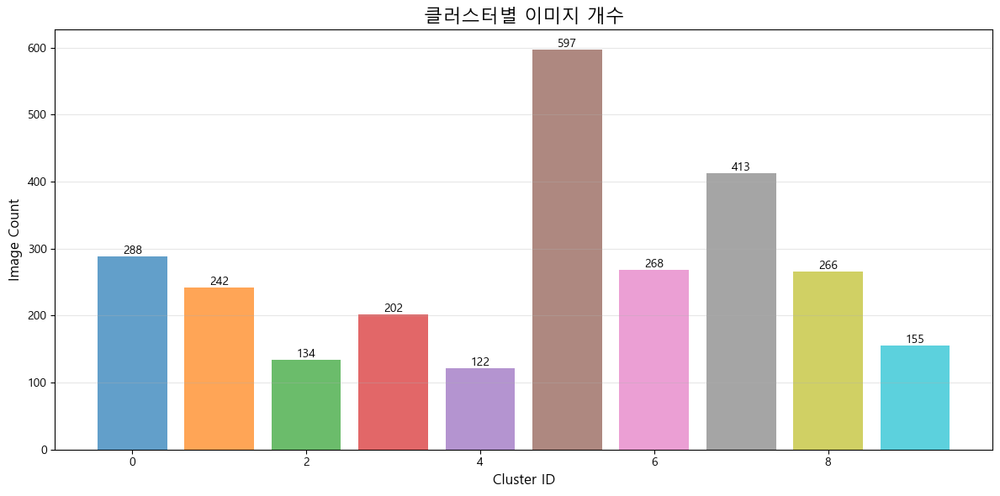


📊 크기 분포:
  최대: 597장 (Cluster 5)
  최소: 122장 (Cluster 4)
  불균형 비율: 4.9배

📊 검증 5: 클러스터 간 거리


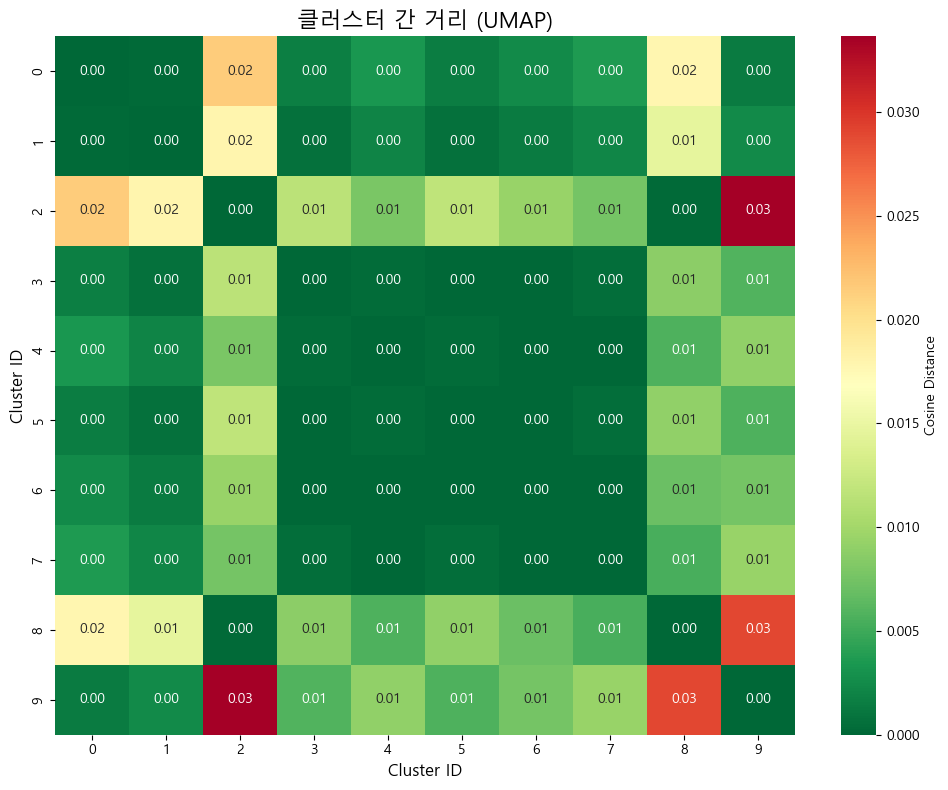


가장 유사한 클러스터: 3 ↔ 5 (거리: 0.000)

✅ 검증 완료!


In [8]:
# ======================================================
# 📊 TryAngle Cluster Validation (수정본)
# ======================================================

import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import adjusted_rand_score
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
import cv2
import os
import random
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# ======================================================
# [1] 데이터 로드 (수정!)
# ======================================================

PARQUET_PATH = r"C:\try_angle\features\clustered_umap_v2_result.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"

print("📂 데이터 로드 중...")
df = pl.read_parquet(PARQUET_PATH)

# ⭐ UMAP 특징 사용 (클러스터링할 때 사용한 것)
umap_cols = [c for c in df.columns if c.startswith("umap_")]

if umap_cols:
    print(f"✅ UMAP 특징 사용: {len(umap_cols)}차원")
    features = df.select(umap_cols).to_numpy()
else:
    print("⚠️ UMAP 특징 없음! 융합 특징 생성 중...")
    # CLIP + DINO + MiDaS 융합
    clip_feats = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
    dino_feats = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
    midas_feats = df.select(["midas_mean", "midas_std"]).to_numpy()
    features = np.concatenate([clip_feats, dino_feats, midas_feats], axis=1)
    print(f"✅ 융합 특징 생성: {features.shape[1]}차원")

labels = df.select("cluster").to_numpy().flatten()
filenames = df.select("filename").to_series().to_list()

print(f"✅ 총 {len(df)}장")
print(f"✅ 클러스터 수: {len(np.unique(labels))}개")

# ======================================================
# [검증 1] t-SNE
# ======================================================

print("\n" + "="*70)
print("📊 검증 1: t-SNE 2D 시각화")
print("="*70)

print("⏳ t-SNE 계산 중 (약 2분)...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
features_2d = tsne.fit_transform(features[:1000])

plt.figure(figsize=(12, 8))
scatter = plt.scatter(features_2d[:, 0], features_2d[:, 1], 
                     c=labels[:1000], cmap='tab10', 
                     alpha=0.6, s=50)
plt.colorbar(scatter, label='Cluster')
plt.title('t-SNE Visualization (UMAP features)', fontsize=16)
plt.xlabel('t-SNE Dimension 1', fontsize=12)
plt.ylabel('t-SNE Dimension 2', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_tsne_fixed.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ t-SNE 플롯 저장: cluster_tsne_fixed.png")

# ======================================================
# [검증 2] Silhouette (수정!)
# ======================================================

print("\n" + "="*70)
print("📊 검증 2: Silhouette 분석")
print("="*70)

overall_sil = silhouette_score(features, labels, sample_size=5000)
print(f"전체 Silhouette Score: {overall_sil:.4f}")

cluster_sil = []
for c in range(len(np.unique(labels))):
    mask = labels == c
    if mask.sum() < 2:
        cluster_sil.append(0)
        continue
    
    sample_sil = silhouette_samples(features, labels)
    cluster_sil.append(sample_sil[mask].mean())

plt.figure(figsize=(12, 6))
colors = plt.cm.tab10(np.arange(len(cluster_sil)))
bars = plt.bar(range(len(cluster_sil)), cluster_sil, color=colors, alpha=0.7)
plt.axhline(y=overall_sil, color='r', linestyle='--', 
            label=f'Overall ({overall_sil:.3f})')
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Silhouette Score', fontsize=12)
plt.title('클러스터별 Silhouette Score (UMAP)', fontsize=16)
plt.legend()
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_silhouette_fixed.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n📊 클러스터별 Silhouette:")
for i, score in enumerate(cluster_sil):
    size = (labels == i).sum()
    grade = "좋음" if score > 0.4 else ("보통" if score > 0.2 else "낮음")
    print(f"  Cluster {i}: {score:.3f} ({size}장) - {grade}")

print("\n✅ Silhouette 플롯 저장")

# ======================================================
# [검증 3] 크기 분포
# ======================================================

print("\n" + "="*70)
print("📊 검증 3: 클러스터 크기 분포")
print("="*70)

cluster_sizes = [(labels == c).sum() for c in range(len(np.unique(labels)))]

plt.figure(figsize=(12, 6))
bars = plt.bar(range(len(cluster_sizes)), cluster_sizes, 
               color=plt.cm.tab10(np.arange(len(cluster_sizes))), alpha=0.7)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Image Count', fontsize=12)
plt.title('클러스터별 이미지 개수', fontsize=16)

for i, (bar, size) in enumerate(zip(bars, cluster_sizes)):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{size}', ha='center', va='bottom', fontsize=10)

plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_sizes_fixed.png', dpi=150, bbox_inches='tight')
plt.show()

max_size = max(cluster_sizes)
min_size = min(cluster_sizes)
imbalance_ratio = max_size / min_size

print(f"\n📊 크기 분포:")
print(f"  최대: {max_size}장 (Cluster {cluster_sizes.index(max_size)})")
print(f"  최소: {min_size}장 (Cluster {cluster_sizes.index(min_size)})")
print(f"  불균형 비율: {imbalance_ratio:.1f}배")

# ======================================================
# [검증 5] 거리 행렬 (수정!)
# ======================================================

print("\n" + "="*70)
print("📊 검증 5: 클러스터 간 거리")
print("="*70)

cluster_centers = []
for c in range(len(np.unique(labels))):
    mask = labels == c
    center = features[mask].mean(axis=0)
    cluster_centers.append(center)

cluster_centers = np.array(cluster_centers)
distance_matrix = cdist(cluster_centers, cluster_centers, metric='cosine')

plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True, fmt='.2f', cmap='RdYlGn_r',
            xticklabels=range(len(cluster_centers)),
            yticklabels=range(len(cluster_centers)),
            cbar_kws={'label': 'Cosine Distance'})
plt.title('클러스터 간 거리 (UMAP)', fontsize=16)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Cluster ID', fontsize=12)
plt.tight_layout()
plt.savefig('cluster_distance_fixed.png', dpi=150, bbox_inches='tight')
plt.show()

min_dist = np.inf
closest_pair = None
for i in range(len(cluster_centers)):
    for j in range(i+1, len(cluster_centers)):
        if distance_matrix[i, j] < min_dist:
            min_dist = distance_matrix[i, j]
            closest_pair = (i, j)

print(f"\n가장 유사한 클러스터: {closest_pair[0]} ↔ {closest_pair[1]} (거리: {min_dist:.3f})")

print("\n✅ 검증 완료!")

In [9]:
import json
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.gridspec as gridspec

# 경로 설정
JSON_PATH = r"C:\try_angle\features\cluster_interpretation.json"
IMG_DIR = r"C:\try_angle\data\train_images"
PARQUET_PATH = r"C:\try_angle\features\clustered_umap_v2_result.parquet"

import polars as pl

# 폰트 설정 (윈도우)
plt.rcParams['font.family'] = "Malgun Gothic"
plt.rcParams['axes.unicode_minus'] = False

print("✅ 라이브러리 로드 완료")


✅ 라이브러리 로드 완료


In [10]:
# JSON 로드
with open(JSON_PATH, "r", encoding="utf-8") as f:
    cluster_info = json.load(f)

df = pl.read_parquet(PARQUET_PATH)

print(f"총 클러스터: {len(cluster_info)}개")
print(f"총 이미지: {len(df):,}장")


총 클러스터: 10개
총 이미지: 2,687장


In [11]:
def load_image(path, size=224):
    img = cv2.imread(path)
    if img is None:
        return None
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (size, size))
    return img

def get_representative_images(df, cluster_id, n=9):
    files = df.filter(pl.col("cluster") == cluster_id)["filename"].to_list()
    files = files[:n] if len(files) >= n else files
    images = []
    for f in files:
        path = os.path.join(IMG_DIR, os.path.basename(f))
        img = load_image(path)
        if img is not None:
            images.append(img)
    return images


In [14]:
def plot_cluster_report(cluster_id, info):
    images = get_representative_images(df, cluster_id, n=9)  # 최대 9장
    img_count = len(images)

    # 그리드 계산 (3x3 고정)
    rows = 3
    cols = 3

    fig = plt.figure(figsize=(12, 10))
    gs = gridspec.GridSpec(rows + 1, cols, height_ratios=[1] + [4, 4, 4])

    # ----------- 상단 텍스트 영역 ----------- #
    ax0 = plt.subplot(gs[0, :])
    ax0.axis("off")

    title = f"Cluster {cluster_id} – {info['auto_label']}"
    text = (
        f"📌 샘플 수: {info['sample_count']}장\n"
        f"🔹 시점(Depth): {info['depth_label']} ({info['depth_mean']:.1f})\n"
        f"🔹 색감: {info['tone']}, {info['brightness']}, {info['saturation']}\n"
        f"🔹 포즈: {info['dominant_pose']} (person_ratio 평균 {info['person_ratio_mean']:.2f})"
    )

    ax0.set_title(title, fontsize=16, fontweight='bold')
    ax0.text(0.5, 0.5, text, ha='center', va='center', fontsize=12)

    # ----------- 이미지 영역 ----------- #
    for i, img in enumerate(images):
        row = i // cols + 1   # +1 because row 0 is the text panel
        col = i % cols
        ax = plt.subplot(gs[row, col])
        ax.imshow(img)
        ax.axis("off")

    plt.tight_layout()
    plt.show()


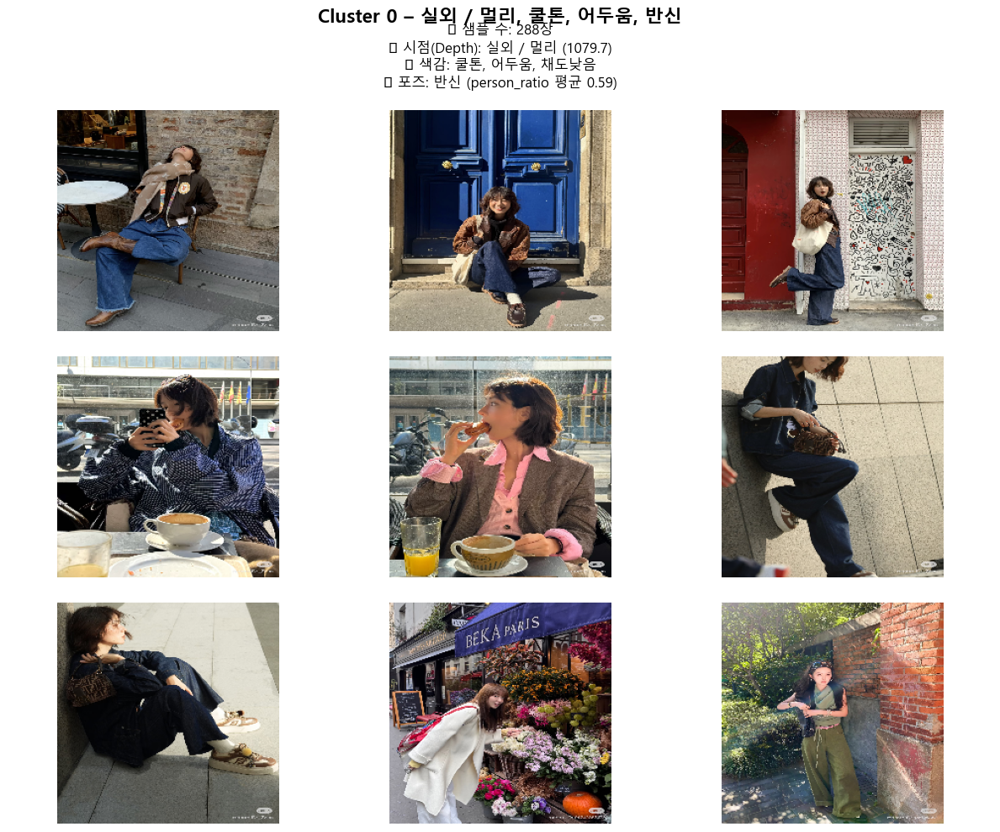

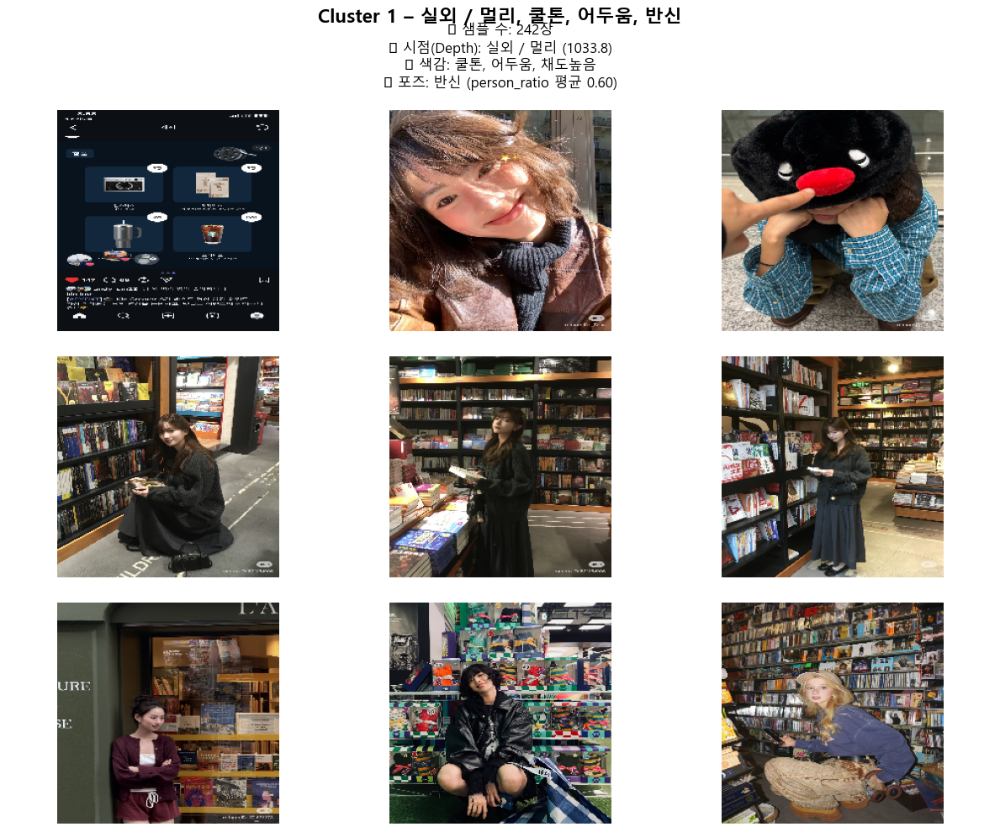

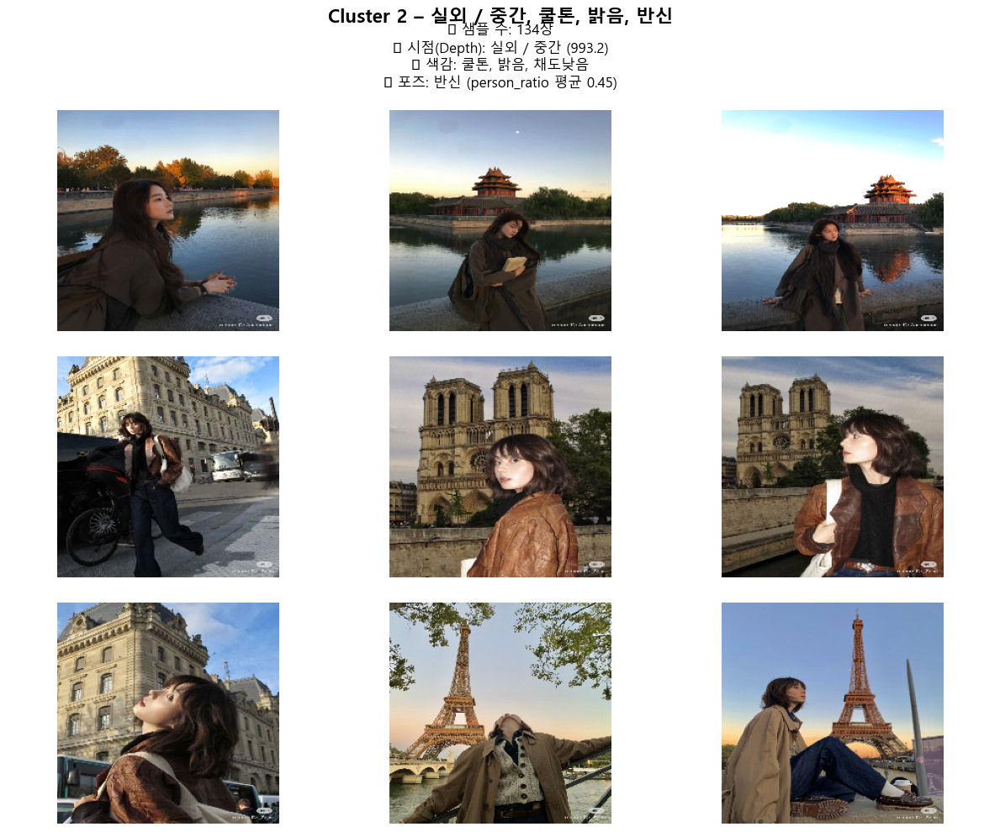

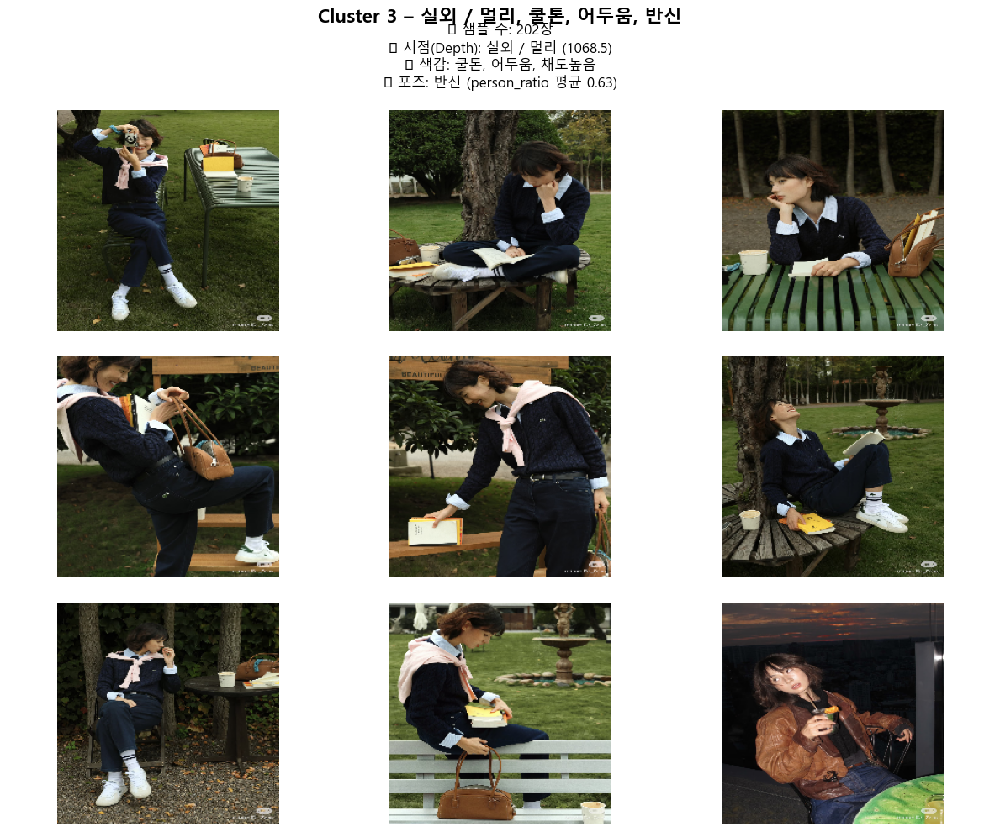

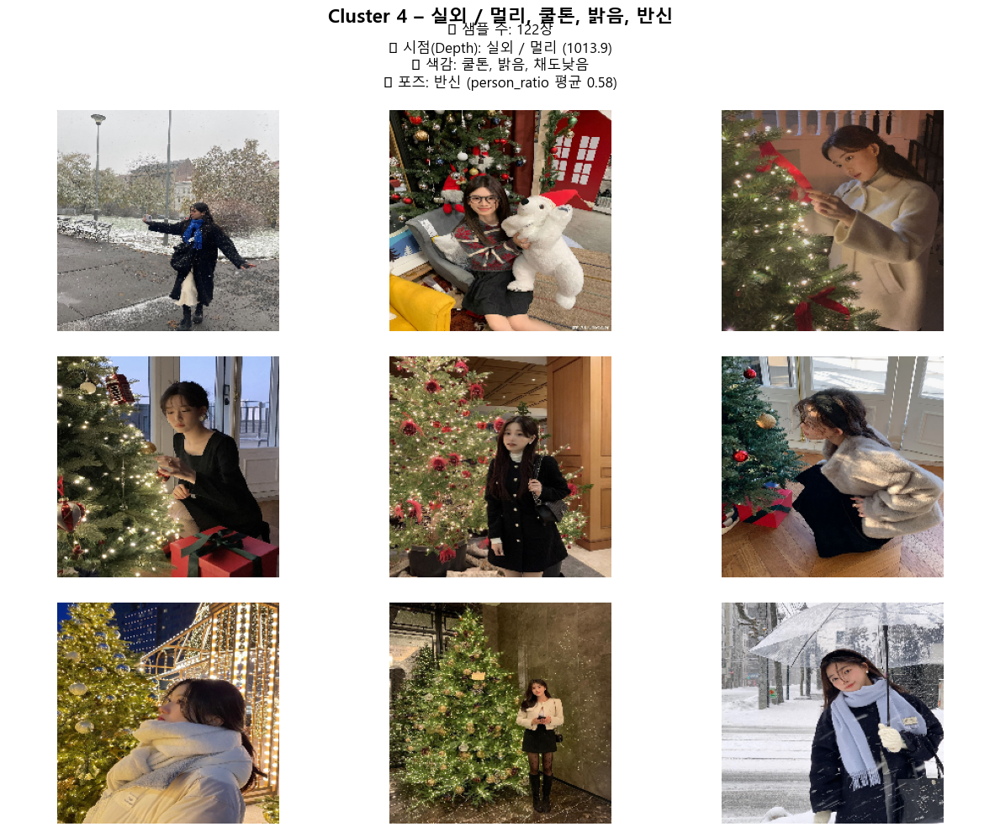

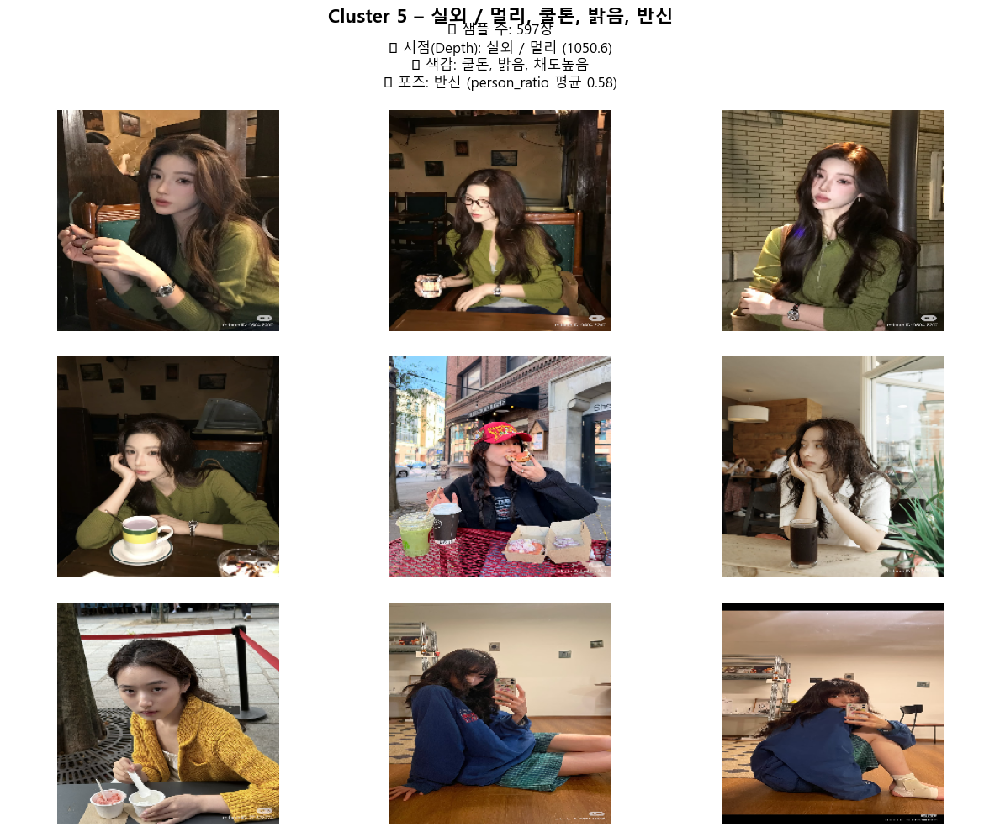

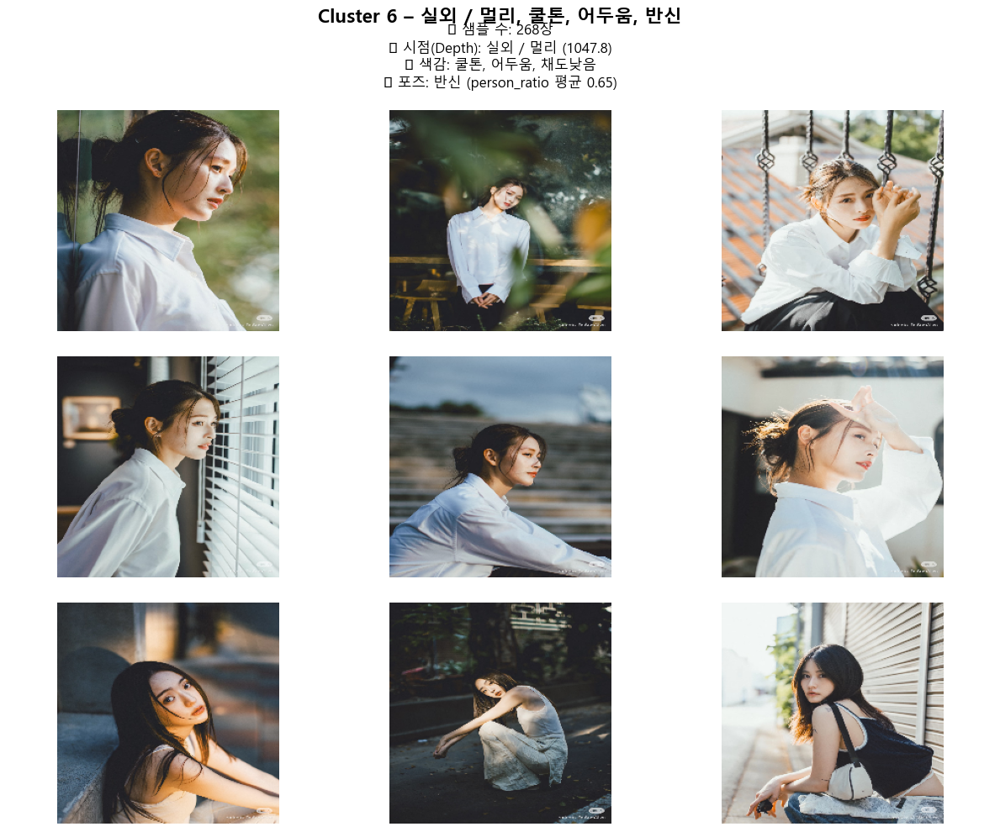

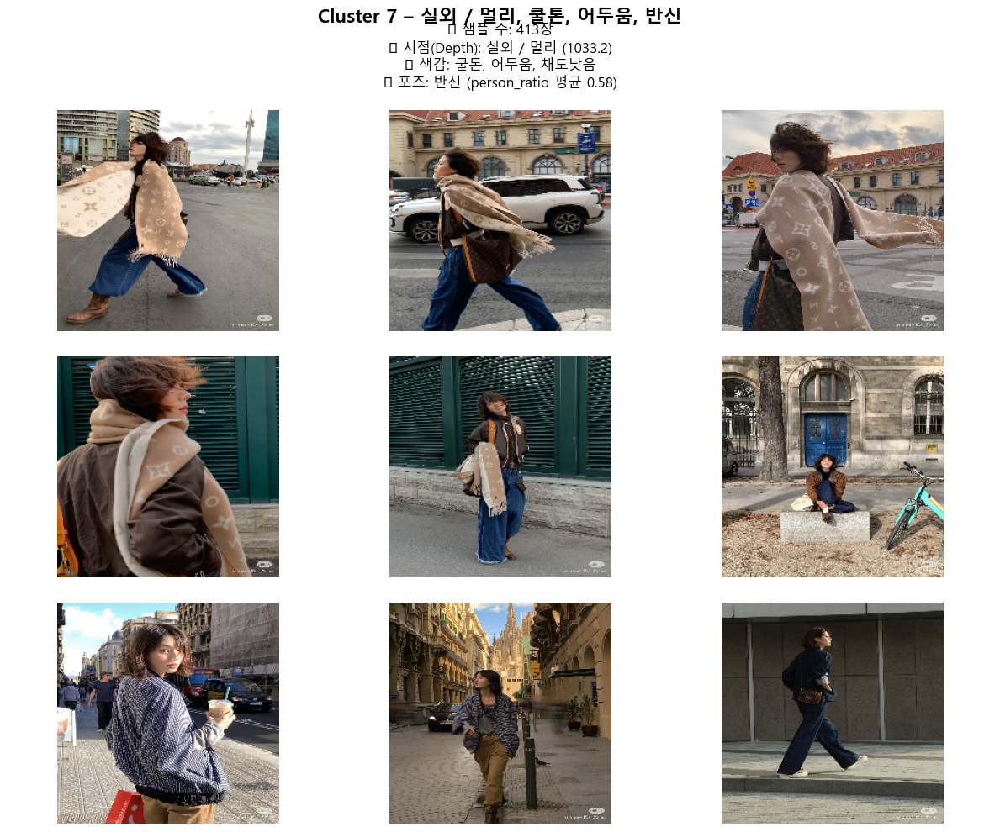

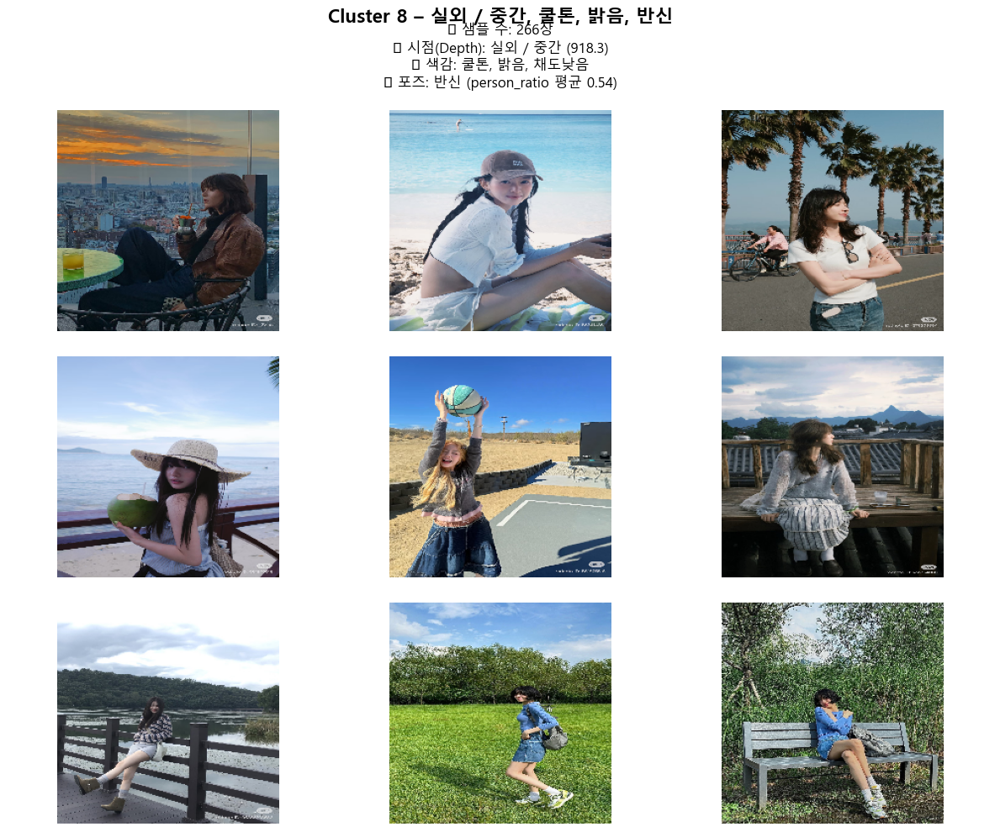

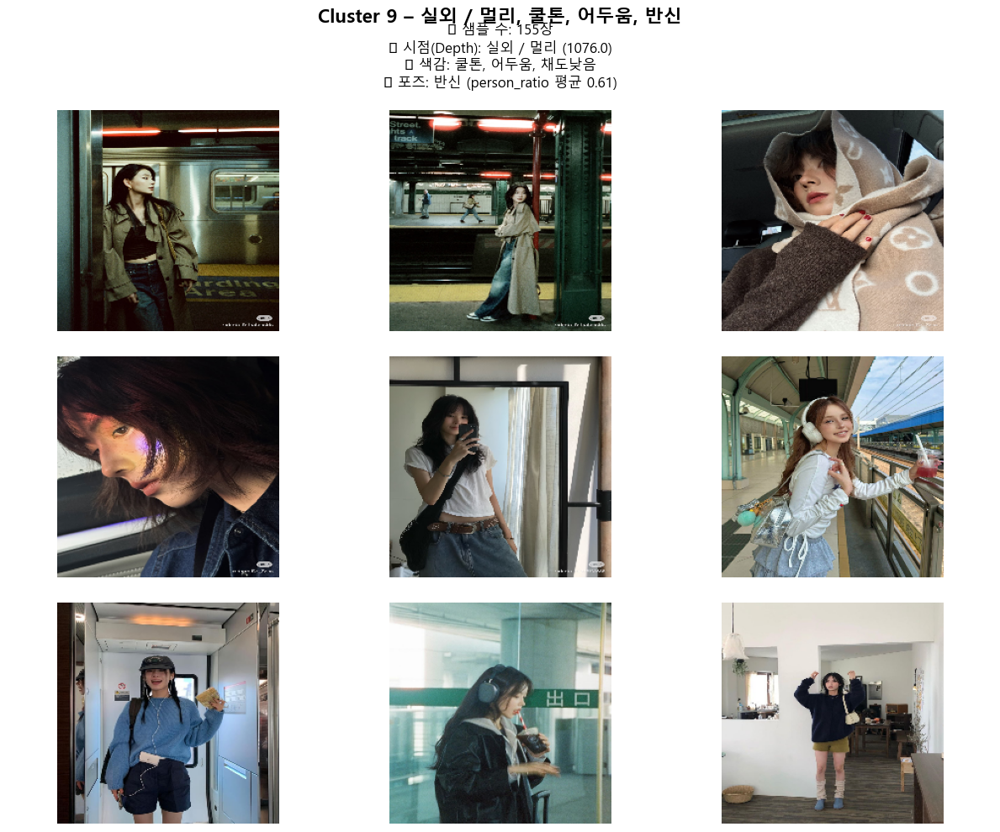

In [15]:
for cid, info in cluster_info.items():
    plot_cluster_report(int(cid), info)


In [16]:
import polars as pl
df = pl.read_parquet(r"C:\try_angle\features\clustered_umap_v2_result.parquet")
print(len([c for c in df.columns if c.startswith("dino_")]))


384


In [17]:
import polars as pl

df = pl.read_parquet(r"C:\try_angle\features\clustered_umap_v2_result.parquet")

print(df["cluster"].value_counts())

# "카페"나 컵" 키워드가 filename에 있는 경우 필터링해보기
df_cafe = df.filter(pl.col("filename").str.contains("cafe|coffee|cup", case=False))
print(df_cafe.select(["filename", "cluster"]).head(20))


shape: (10, 2)
┌─────────┬───────┐
│ cluster ┆ count │
│ ---     ┆ ---   │
│ i32     ┆ u32   │
╞═════════╪═══════╡
│ 5       ┆ 597   │
│ 6       ┆ 268   │
│ 9       ┆ 155   │
│ 0       ┆ 288   │
│ 1       ┆ 242   │
│ 2       ┆ 134   │
│ 4       ┆ 122   │
│ 8       ┆ 266   │
│ 7       ┆ 413   │
│ 3       ┆ 202   │
└─────────┴───────┘


TypeError: ExprStringNameSpace.contains() got an unexpected keyword argument 'case'

📂 데이터 로드 중...
✅ 총 2687장 로드
✅ 클러스터 수: 10개

📊 검증 1: t-SNE 2D 시각화
⏳ t-SNE 계산 중 (약 2~3분)...


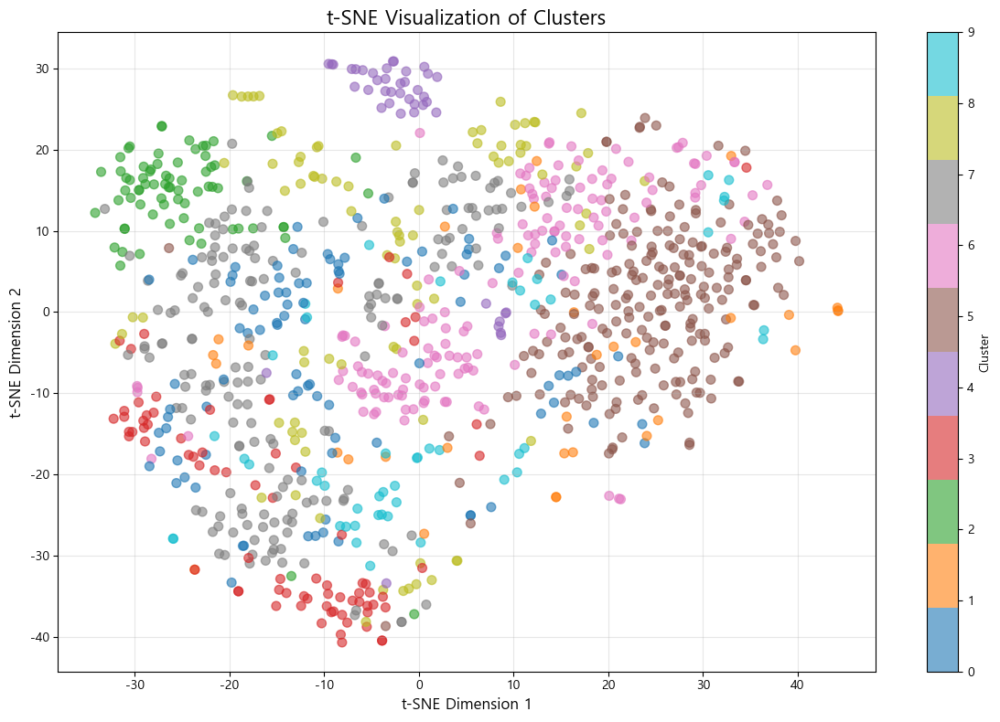

✅ t-SNE 플롯 저장: cluster_tsne.png

📊 검증 2: Silhouette 분석
전체 Silhouette Score: 0.0137


ValueError: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)

In [18]:
# ======================================================
# 📊 TryAngle Cluster Validation Notebook
# 클러스터링 품질 검증 (현업 스타일)
# ======================================================

import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import confusion_matrix, adjusted_rand_score
import cv2
from PIL import Image
import os
from IPython.display import display, HTML
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows)
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

# ======================================================
# [1] 데이터 로드
# ======================================================

PARQUET_PATH = r"C:\try_angle\features\clustered_umap_v2_result.parquet"
IMG_DIR = r"C:\try_angle\data\train_images"
CLUSTER_DIR = r"C:\try_angle\data\clustered_images"

print("📂 데이터 로드 중...")
df = pl.read_parquet(PARQUET_PATH)

# 특징 추출
clip_feats = df.select([c for c in df.columns if c.startswith("clip_")]).to_numpy()
dino_feats = df.select([c for c in df.columns if c.startswith("dino_")]).to_numpy()
labels = df.select("cluster").to_numpy().flatten()
filenames = df.select("filename").to_series().to_list()

print(f"✅ 총 {len(df)}장 로드")
print(f"✅ 클러스터 수: {len(np.unique(labels))}개")

# ======================================================
# [검증 1] 시각화 - t-SNE 2D 플롯
# ======================================================

print("\n" + "="*70)
print("📊 검증 1: t-SNE 2D 시각화")
print("="*70)

# t-SNE 차원 축소 (시각화용)
print("⏳ t-SNE 계산 중 (약 2~3분)...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000)
features_2d = tsne.fit_transform(clip_feats[:1000])  # 샘플 1000개만 (속도)

# 플롯
plt.figure(figsize=(12, 8))
scatter = plt.scatter(features_2d[:, 0], features_2d[:, 1], 
                     c=labels[:1000], cmap='tab10', 
                     alpha=0.6, s=50)
plt.colorbar(scatter, label='Cluster')
plt.title('t-SNE Visualization of Clusters', fontsize=16)
plt.xlabel('t-SNE Dimension 1', fontsize=12)
plt.ylabel('t-SNE Dimension 2', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_tsne.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ t-SNE 플롯 저장: cluster_tsne.png")

# ======================================================
# [검증 2] Silhouette 분석 (클러스터별)
# ======================================================

print("\n" + "="*70)
print("📊 검증 2: Silhouette 분석")
print("="*70)

# 전체 Silhouette
overall_sil = silhouette_score(clip_feats, labels, sample_size=5000)
print(f"전체 Silhouette Score: {overall_sil:.4f}")

# 클러스터별 Silhouette
cluster_sil = []
for c in range(len(np.unique(labels))):
    mask = labels == c
    if mask.sum() < 2:
        cluster_sil.append(0)
        continue
    
    # 클러스터 내 샘플들의 Silhouette
    sample_sil = silhouette_samples(clip_feats[mask], labels[mask])
    cluster_sil.append(sample_sil.mean())

# 막대 그래프
plt.figure(figsize=(12, 6))
colors = plt.cm.tab10(np.arange(len(cluster_sil)))
bars = plt.bar(range(len(cluster_sil)), cluster_sil, color=colors, alpha=0.7)
plt.axhline(y=overall_sil, color='r', linestyle='--', label=f'Overall ({overall_sil:.3f})')
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Silhouette Score', fontsize=12)
plt.title('클러스터별 Silhouette Score', fontsize=16)
plt.legend()
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_silhouette.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n📊 클러스터별 Silhouette:")
for i, score in enumerate(cluster_sil):
    size = (labels == i).sum()
    grade = "좋음" if score > 0.4 else ("보통" if score > 0.2 else "낮음")
    print(f"  Cluster {i}: {score:.3f} ({size}장) - {grade}")

print("\n✅ Silhouette 플롯 저장: cluster_silhouette.png")

# ======================================================
# [검증 3] 클러스터 크기 분포
# ======================================================

print("\n" + "="*70)
print("📊 검증 3: 클러스터 크기 분포")
print("="*70)

cluster_sizes = [((labels == c).sum()) for c in range(len(np.unique(labels)))]

plt.figure(figsize=(12, 6))
bars = plt.bar(range(len(cluster_sizes)), cluster_sizes, 
               color=plt.cm.tab10(np.arange(len(cluster_sizes))), alpha=0.7)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Image Count', fontsize=12)
plt.title('클러스터별 이미지 개수', fontsize=16)

# 막대 위에 숫자 표시
for i, (bar, size) in enumerate(zip(bars, cluster_sizes)):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{size}',
             ha='center', va='bottom', fontsize=10)

plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('cluster_sizes.png', dpi=150, bbox_inches='tight')
plt.show()

# 불균형 체크
max_size = max(cluster_sizes)
min_size = min(cluster_sizes)
imbalance_ratio = max_size / min_size

print(f"\n📊 크기 분포:")
print(f"  최대: {max_size}장 (Cluster {cluster_sizes.index(max_size)})")
print(f"  최소: {min_size}장 (Cluster {cluster_sizes.index(min_size)})")
print(f"  불균형 비율: {imbalance_ratio:.1f}배")

if imbalance_ratio > 10:
    print("  ⚠️ 경고: 클러스터 크기 불균형이 큽니다 (10배 이상)")
elif imbalance_ratio > 5:
    print("  ⚠️ 주의: 클러스터 크기 차이가 있습니다 (5배 이상)")
else:
    print("  ✅ 양호: 클러스터 크기가 비교적 균형적입니다")

print("\n✅ 크기 분포 플롯 저장: cluster_sizes.png")

# ======================================================
# [검증 4] 대표 이미지 그리드 (시각적 검증)
# ======================================================

print("\n" + "="*70)
print("📊 검증 4: 대표 이미지 그리드")
print("="*70)

def create_cluster_grid(cluster_id, n_samples=9):
    """클러스터 대표 이미지 그리드 생성"""
    cluster_files = [f for i, f in enumerate(filenames) if labels[i] == cluster_id]
    
    # 랜덤 샘플링
    if len(cluster_files) > n_samples:
        import random
        cluster_files = random.sample(cluster_files, n_samples)
    
    n_samples = len(cluster_files)
    n_cols = 3
    n_rows = (n_samples + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 4*n_rows))
    axes = axes.flatten() if n_samples > 1 else [axes]
    
    for idx, fname in enumerate(cluster_files):
        img_path = os.path.join(IMG_DIR, os.path.basename(fname))
        
        try:
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (300, 400))
                axes[idx].imshow(img)
                axes[idx].set_title(os.path.basename(fname)[:20], fontsize=8)
                axes[idx].axis('off')
        except Exception as e:
            axes[idx].text(0.5, 0.5, 'Load Error', 
                          ha='center', va='center')
            axes[idx].axis('off')
    
    # 빈 subplot 제거
    for idx in range(n_samples, len(axes)):
        axes[idx].axis('off')
    
    plt.suptitle(f'Cluster {cluster_id} 대표 이미지 ({len(cluster_files)}장 샘플)', 
                 fontsize=16, y=1.00)
    plt.tight_layout()
    plt.savefig(f'cluster_{cluster_id}_samples.png', dpi=100, bbox_inches='tight')
    plt.show()

# 각 클러스터 시각화 (0, 5, 8번만 예시)
for c in [0, 5, 8]:
    print(f"\n클러스터 {c} 시각화 중...")
    create_cluster_grid(c, n_samples=9)

print("\n✅ 대표 이미지 저장 완료")

# ======================================================
# [검증 5] 클러스터 간 거리 행렬
# ======================================================

print("\n" + "="*70)
print("📊 검증 5: 클러스터 간 거리 분석")
print("="*70)

# 클러스터 중심 계산
cluster_centers = []
for c in range(len(np.unique(labels))):
    mask = labels == c
    center = clip_feats[mask].mean(axis=0)
    cluster_centers.append(center)

cluster_centers = np.array(cluster_centers)

# 거리 행렬 계산 (코사인 거리)
from scipy.spatial.distance import cdist
distance_matrix = cdist(cluster_centers, cluster_centers, metric='cosine')

# 히트맵
plt.figure(figsize=(10, 8))
sns.heatmap(distance_matrix, annot=True, fmt='.2f', cmap='RdYlGn_r',
            xticklabels=range(len(cluster_centers)),
            yticklabels=range(len(cluster_centers)),
            cbar_kws={'label': 'Cosine Distance'})
plt.title('클러스터 간 거리 행렬 (낮을수록 유사)', fontsize=16)
plt.xlabel('Cluster ID', fontsize=12)
plt.ylabel('Cluster ID', fontsize=12)
plt.tight_layout()
plt.savefig('cluster_distance_matrix.png', dpi=150, bbox_inches='tight')
plt.show()

print("✅ 거리 행렬 저장: cluster_distance_matrix.png")

# 가장 가까운 클러스터 쌍
min_dist = np.inf
closest_pair = None
for i in range(len(cluster_centers)):
    for j in range(i+1, len(cluster_centers)):
        if distance_matrix[i, j] < min_dist:
            min_dist = distance_matrix[i, j]
            closest_pair = (i, j)

print(f"\n가장 유사한 클러스터: {closest_pair[0]} ↔ {closest_pair[1]} (거리: {min_dist:.3f})")
print("  → 이 두 클러스터를 합칠지 고려해볼 수 있습니다")

# ======================================================
# [검증 6] 안정성 테스트 (Stability Test)
# ======================================================

print("\n" + "="*70)
print("📊 검증 6: 클러스터링 안정성 테스트")
print("="*70)

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

print("⏳ 안정성 테스트 중 (약 1분)...")

stability_scores = []
n_trials = 5

for trial in range(n_trials):
    # 데이터 80% 샘플링
    sample_idx = np.random.choice(len(clip_feats), size=int(len(clip_feats)*0.8), replace=False)
    sample_feats = clip_feats[sample_idx]
    sample_labels = labels[sample_idx]
    
    # 재클러스터링
    km = KMeans(n_clusters=10, random_state=trial, n_init=10)
    new_labels = km.fit_predict(sample_feats)
    
    # ARI (Adjusted Rand Index) 계산
    ari = adjusted_rand_score(sample_labels, new_labels)
    stability_scores.append(ari)

avg_stability = np.mean(stability_scores)
std_stability = np.std(stability_scores)

print(f"\n안정성 점수 (ARI): {avg_stability:.3f} ± {std_stability:.3f}")

if avg_stability > 0.8:
    print("  ✅ 우수: 클러스터링이 매우 안정적입니다")
elif avg_stability > 0.6:
    print("  ✅ 양호: 클러스터링이 비교적 안정적입니다")
elif avg_stability > 0.4:
    print("  ⚠️ 보통: 약간의 변동성이 있습니다")
else:
    print("  ⚠️ 주의: 클러스터링이 불안정합니다 (파라미터 조정 필요)")

# ======================================================
# [종합 리포트]
# ======================================================

print("\n" + "="*70)
print("📋 종합 검증 리포트")
print("="*70)

report = f"""
✅ 데이터 품질
  - 총 샘플 수: {len(df)}장
  - 클러스터 수: {len(np.unique(labels))}개
  
✅ 정량 지표
  - Silhouette Score: {overall_sil:.4f} ({'우수' if overall_sil > 0.4 else '양호' if overall_sil > 0.2 else '낮음'})
  - 안정성 (ARI): {avg_stability:.3f} ({'안정' if avg_stability > 0.6 else '보통' if avg_stability > 0.4 else '불안정'})
  
✅ 균형성
  - 최대/최소 비율: {imbalance_ratio:.1f}배 ({'양호' if imbalance_ratio < 5 else '주의' if imbalance_ratio < 10 else '불균형'})
  
✅ 분리도
  - 가장 가까운 클러스터: {closest_pair[0]} ↔ {closest_pair[1]} (거리: {min_dist:.3f})
  - {'분리 양호' if min_dist > 0.3 else '일부 중첩'}
  
💡 권장 사항:
"""

if overall_sil < 0.3:
    report += "  - Silhouette가 낮음 → 클러스터 수 조정 권장 (5~15개 테스트)\n"
if imbalance_ratio > 10:
    report += "  - 크기 불균형 → 큰 클러스터 세분화 고려\n"
if min_dist < 0.2:
    report += f"  - Cluster {closest_pair[0]}와 {closest_pair[1]} 병합 고려\n"
if avg_stability < 0.5:
    report += "  - 안정성 낮음 → 샘플 수 늘리거나 특징 재선택\n"

if overall_sil > 0.4 and avg_stability > 0.6 and imbalance_ratio < 5:
    report += "  ✅ 현재 클러스터링이 우수합니다! 그대로 사용 가능합니다.\n"

print(report)

# 리포트 저장
with open('clustering_validation_report.txt', 'w', encoding='utf-8') as f:
    f.write(report)

print("\n✅ 리포트 저장: clustering_validation_report.txt")
print("="*70)


In [25]:
import polars as pl

df = pl.read_parquet(r"C:\try_angle\features\clustered_umap_v2_result.parquet")

print(df["cluster"].value_counts())

# 카페/커피/컵 문자열 포함된 이미지 찾기 (구버전 호환)
df_cafe = df.filter(
    pl.col("filename").str.contains("cafe|coffee|cup")
)

print(df_cafe.select(["filename", "cluster"]).head(30))


shape: (10, 2)
┌─────────┬───────┐
│ cluster ┆ count │
│ ---     ┆ ---   │
│ i32     ┆ u32   │
╞═════════╪═══════╡
│ 6       ┆ 268   │
│ 3       ┆ 202   │
│ 9       ┆ 155   │
│ 4       ┆ 122   │
│ 7       ┆ 413   │
│ 5       ┆ 597   │
│ 1       ┆ 242   │
│ 8       ┆ 266   │
│ 0       ┆ 288   │
│ 2       ┆ 134   │
└─────────┴───────┘
shape: (0, 2)
┌──────────┬─────────┐
│ filename ┆ cluster │
│ ---      ┆ ---     │
│ str      ┆ i32     │
╞══════════╪═════════╡
└──────────┴─────────┘
